# GANomaly
- 2020.08.16 : gen 1 / lr 3e-2

# 개발일지
- 2020.08.15 : 분율 추출 구현 / 이상치 상관계수 추출 구현 / 모델 save, load 구현
- 2020.08.16 : anomaly detect 이미지 저장 구현 / 티타늄(Ti64) 상대 밀도 계산 구현

--- 

# Module

In [1]:
import torch
import torch.nn as nn
import torchvision
from torchvision import transforms
from torchvision.utils import save_image
import os
import numpy as np

import torchvision.datasets as dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils

# Graph & Animation
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Hyper Parameter

In [2]:
latent_size = 100  # z벡터의 잠재공간(latent space)의 크기
workers = 4    # 0일때, 약 20% 사용 4일 경우 메모리 100%
img_size = 64
channel = 1
epochs = 100
batch_size = 64
learning_rate = 3e-2

# Data and Device

In [3]:
# 이미지 경로, 이미지들 리사이즈 및 텐서형태로 만들기
#data_root = "../../dataset/train"
CFRP_aug_data_root = "../../dataset/aug_train/aug_CFRP"

data_set = dataset.ImageFolder(root = CFRP_aug_data_root, # data_root,
                           transform = transforms.Compose([
                                  #transforms.Resize(img_size),
                                  transforms.CenterCrop(img_size),
                                  torchvision.transforms.Grayscale(channel),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5,),(0.5,))
                              ]))

print("size of dataset :", len(data_set))

# 배치로 나누고 셔플하기
data_loader = torch.utils.data.DataLoader(data_set, batch_size = batch_size,
                                         shuffle = True, num_workers = workers, drop_last=True)

# Device setting (GPU or CPU)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print("device :", device)

size of dataset : 1368
device : cuda:0


# MODEL

In [4]:
# GANomaly : Generative Adversarial Networks Model using Decoder with AutoEncoder

# === Decoder 모델 ===
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        
        # Batch Normalization 유무에 따른 G_block 정의
        def DC_conv_block(in_features, out_features):
            block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
            ]
            return block
        
        def DC_deconv_block(in_features, out_features, FIRST=True):
            if FIRST:
                block = [
                    nn.ConvTranspose2d(in_features, out_features, 4, 1, 0, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            else:
                block = [
                    nn.ConvTranspose2d(in_features, out_features, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            return block
        
        
        # ======================= 픽셀 분포 생성 layer ======================= 
        self.DC_gen_distribution = nn.Sequential(
            # ------ input is latent_size 100 ------ 
            *DC_deconv_block(latent_size, img_size*8, FIRST=True),
            # ------ state size is 512x4x4 ------ 
            *DC_conv_block(img_size*8, img_size*8),
            # ------ state size is 512x4x4 ------   
            *DC_deconv_block(img_size*8, img_size*4, FIRST=False),
            # ------ state size is 256x8x8 ------ 
            *DC_conv_block(img_size*4, img_size*4),
            # ------ state size is 256x8x8 ------ 
            *DC_deconv_block(img_size*4, img_size*2, FIRST=False),
            # ------ state size is 128x16x16 ------ 
            *DC_conv_block(img_size*2, img_size*2),
            # ------ state size is 128x16x16 ------ 
            *DC_deconv_block(img_size*2, img_size, FIRST=False),
        )
        
        # =================== 가짜 이미지 생성 layer =================== 
        self.DC_gen_fake_img = nn.Sequential(
            # ------ state size is 64x32x32 ------ 
            nn.ConvTranspose2d(img_size, 1, 4, 2, 1, bias=False),
            nn.Tanh() # 픽셀값의 범위 : -1 ~ 1로 두기 위해서
            # ------ state size is 1x64x64 ------ 
        )
    
    def forward(self, input):
        distribution = self.DC_gen_distribution(input)
        fake_img = self.DC_gen_fake_img(distribution)
        
        return fake_img


# === Discriminator 모델 ===
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # Batch Normalization 유무에 따른 D_block 정의
        def D_block(in_features, out_features, MP=True):
            if MP:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            else:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU(),
                    nn.MaxPool2d(2)
                ]
            return block
        
        # ============== Feature 추출 layer ==============
        self.D_extract_feature = nn.Sequential(
            # ------ input is 1 x 64 x 64 ------ 
            *D_block(channel, img_size, MP=False),
            # ------ input is 64 x 64 x 64 ------ 
            *D_block(img_size, img_size, MP=True),
            # ------ state is 64 x 32 x 32 ------ 
            *D_block(img_size, img_size*2, MP=False),
            # ------ state is 128 x 32 x 32 ------ 
            *D_block(img_size*2, img_size*2, MP=True),
            # ------ state is 128 x 16 x 16 ------ 
            *D_block(img_size*2, img_size*4, MP=False),
            # ------ state is 256 x 16 x 16 ------ 
            *D_block(img_size*4, img_size*4, MP=True),
            # ------ state is 256 x 8 x 8 ------ 
            *D_block(img_size*4, img_size*8, MP=False),
            # ------ state is 512 x 8 x 8 ------ 
            *D_block(img_size*8, img_size*8, MP=True),
        )
        
        # ===================== 이진 분류 layer =====================
        self.D_classification = nn.Sequential(        
            # ------- state size 512x4x4 ------- 
            nn.Conv2d(img_size*8, channel, 4, 1, 0, bias=False),
            #nn.Linear(fms*8*4*4, 1, bias=False),
            nn.Sigmoid()        
        )
        
    def forward(self, input):
        feature = self.D_extract_feature(input)
        classification = self.D_classification(feature)
        
        return classification, feature 


# === Encoder Model ===
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        
        def EC_block(in_features, out_features, MP=True):
            if MP:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU()
                ]
            else:
                block = [
                    nn.Conv2d(in_features, out_features, 3, 1, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ELU(),
                    nn.MaxPool2d(2)
                ]
            return block
        
        # ============== Feature 추출 ==============
        self.EC_extract_feature = nn.Sequential(
            # ------ input is 1 x 64 x 64 ------ 
            *EC_block(channel, img_size, MP=False),
            # ------ input is 64 x 64 x 64 ------ 
            *EC_block(img_size, img_size, MP=True),
            # ------ state is 64 x 32 x 32 ------ 
            *EC_block(img_size, img_size*2, MP=False),
            # ------ state is 128 x 32 x 32 ------ 
            *EC_block(img_size*2, img_size*2, MP=True),
            # ------ state is 128 x 16 x 16 ------ 
            *EC_block(img_size*2, img_size*4, MP=False),
            # ------ state is 256 x 16 x 16 ------ 
            *EC_block(img_size*4, img_size*4, MP=True),
            # ------ state is 256 x 8 x 8 ------ 
            *EC_block(img_size*4, img_size*8, MP=False),
            # ------ state is 512 x 8 x 8 ------ 
            *EC_block(img_size*8, img_size*8, MP=True),
        )
        
        # =============== Encoder Training layer ===============
        self.EC_validate = nn.Sequential(
            # -------state is 512 x 4 x 4-------
            nn.Conv2d(img_size*8, latent_size, 4, 1, 0, bias=False),
            nn.Tanh()
            # -------state is 100 x 97 x 97-------
        )
        
    def forward(self, input):
        feature = self.EC_extract_feature(input)
        validity = self.EC_validate(feature)
        
        return validity

# Loss & Optim

In [5]:
# DC and D 무게 초기화, classname 에 찾는 name가 없다면 -1 ,
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# D,DC,EC 네트워크 모델 객체 선언
D = Discriminator().to(device)
DC = Decoder().to(device)
EC = Encoder().to(device)

# weight initialize/ nn.Module 클래스 안에 apply 함수가 정의되 있음, 각 함수들에 다 적용 하게한다
D.apply(weights_init)
DC.apply(weights_init)
EC.apply(weights_init)

# Binary cross entropy loss and optimizer
DCGAN_criterion = nn.BCELoss()
AE_criterion = nn.MSELoss()

# latent vector에 배치 사이즈 64를 적용
# 학습한 DC로 새로운 것 만들어서 결과 확인 할때 사용
noise_z = torch.randn(img_size, latent_size, 1, 1, device = device)

# D와 DC에 대해 두가지 최적화 설정
D_optimizer = torch.optim.Adam(D.parameters(), lr = learning_rate, betas=(0.5,0.999))
DC_optimizer = torch.optim.Adam(DC.parameters(), lr = learning_rate, betas=(0.5,0.999))
EC_optimizer = torch.optim.Adam(EC.parameters(), lr = learning_rate, betas=(0.5,0.999))

#print(D)
#print(DC)
#print(EC)

def reset_grad():
    D_optimizer.zero_grad()
    DC_optimizer.zero_grad()

---

# Train DCGAN

In [6]:
img_list = []
DC_losses = []
D_losses = []
iters = 0

def train_DCGAN(epoch, learning_DC_per_D = 4):
    global epochs
    global iters
    
    # 인덱스 0부터 세기 시작
    # data[0].size():64x1x64x64(image) / data[1].size():64(label)
    for i,data in enumerate(data_loader,0):
        
        # Train D
        real_img = data[0].to(device) # image size: 64x1x64x64(batch, channel, width, height)
        b_size = real_img.size(0) # b_size = 64
        real_labels = torch.ones(b_size, 1).to(device)
        fake_labels = torch.zeros(b_size, 1).to(device)
        
        # (--------------------------real-----------------------------)
        real_classification, _ = D(real_img) # output = D(x)
        real_loss = DCGAN_criterion(real_classification, real_labels) # D(x)=1일 때의 loss
        real_score = real_classification
        D_x = real_score.mean().item() 
            
        # (--------------------------fake-----------------------------)
        z = torch.randn(b_size, latent_size, 1, 1).to(device) # z size :64x100x1x1
        fake_img = DC(z)
        fake_classification, _ = D(fake_img) # output = D(DC(z))
        fake_loss = DCGAN_criterion(fake_classification, fake_labels) # D(DC(z))=0일 때의 loss
        fake_score = fake_classification
        D_DC_z1 = fake_score.mean().item()

        # (------------------Backprop and optimize---------------------)
        D_loss = real_loss + fake_loss
        reset_grad()
        D_loss.backward()
        D_optimizer.step() # D(x)=1, D(DC(z))=0이어야 D가 최적

        
        # Train DC
        #z = torch.randn(b_size,latent_size,1,1,device=device) # z size :64x100x1x1
        for k in range(learning_DC_per_D):
            fake_img = DC(z)
            fake_classification,_ = D(fake_img)  # output : D(DC(z))
            D_DC_z2 = fake_classification.mean().item()
            DC_loss = DCGAN_criterion(fake_classification, real_labels) # D(DC(z))=1일 때의 loss=log(D(DC(z)))

            # (------------------Backprop and optimize---------------------)
            reset_grad()
            DC_loss.backward()
            DC_optimizer.step() # D(DC(z))=1 이어야 DC가 최적
            # ==> D(DC(z))의 값이 0.5로 수렴해야 한다.
        
        
        # print
        print('[%d/%d][%d/%d]\n- D_loss : %.4f / DC_loss : %.4f\n- D(x):%.4f / D(DC(z1)) : %.4f / D(DC(z2)) : %.4f' 
                   %(epoch+1, epochs, i, len(data_loader),D_loss.item(),
                     DC_loss.item(),D_x,D_DC_z1,D_DC_z2))
        
        # Save Losses for plotting later
        DC_losses.append(DC_loss.item())
        D_losses.append(D_loss.item())
        
        #Check how the generator is doing by saving G's output on noise_z
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = DC(noise_z).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        
#torch.save(E.state_dict(), 'E.ckpt')

In [7]:
for epoch in range(epochs):
    train_DCGAN(epoch, learning_DC_per_D = 1)

/home/piai/anaconda3/envs/pytorch/lib/python3.6/site-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([64, 1])) that is different to the input size (torch.Size([64, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


[1/100][0/21]
- D_loss : 1.3843 / DC_loss : 2.0341
- D(x):0.5008 / D(DC(z1)) : 0.4995 / D(DC(z2)) : 0.1431
[1/100][1/21]
- D_loss : 0.9991 / DC_loss : 0.0000
- D(x):0.5186 / D(DC(z1)) : 0.2047 / D(DC(z2)) : 1.0000
[1/100][2/21]
- D_loss : 11.8272 / DC_loss : 6.6311
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 0.0016
[1/100][3/21]
- D_loss : 5.7012 / DC_loss : 0.2643
- D(x):0.0161 / D(DC(z1)) : 0.0041 / D(DC(z2)) : 0.7678
[1/100][4/21]
- D_loss : 1.8819 / DC_loss : 3.7395
- D(x):0.7815 / D(DC(z1)) : 0.8038 / D(DC(z2)) : 0.0243
[1/100][5/21]
- D_loss : 1.2652 / DC_loss : 1.9244
- D(x):0.6135 / D(DC(z1)) : 0.4406 / D(DC(z2)) : 0.1682
[1/100][6/21]
- D_loss : 3.2508 / DC_loss : 5.8148
- D(x):0.3478 / D(DC(z1)) : 0.8584 / D(DC(z2)) : 0.0030
[1/100][7/21]
- D_loss : 1.6938 / DC_loss : 3.3512
- D(x):0.2748 / D(DC(z1)) : 0.0035 / D(DC(z2)) : 0.0364
[1/100][8/21]
- D_loss : 1.4984 / DC_loss : 5.2670
- D(x):0.6944 / D(DC(z1)) : 0.6626 / D(DC(z2)) : 0.0053
[1/100][9/21]
- D_loss : 1.1293 / DC

[4/100][14/21]
- D_loss : 0.0190 / DC_loss : 7.1766
- D(x):0.9859 / D(DC(z1)) : 0.0008 / D(DC(z2)) : 0.0013
[4/100][15/21]
- D_loss : 0.0110 / DC_loss : 6.7941
- D(x):0.9918 / D(DC(z1)) : 0.0013 / D(DC(z2)) : 0.0019
[4/100][16/21]
- D_loss : 0.0059 / DC_loss : 6.5385
- D(x):0.9961 / D(DC(z1)) : 0.0018 / D(DC(z2)) : 0.0023
[4/100][17/21]
- D_loss : 0.0062 / DC_loss : 6.4568
- D(x):0.9960 / D(DC(z1)) : 0.0021 / D(DC(z2)) : 0.0023
[4/100][18/21]
- D_loss : 0.0035 / DC_loss : 6.5234
- D(x):0.9988 / D(DC(z1)) : 0.0023 / D(DC(z2)) : 0.0022
[4/100][19/21]
- D_loss : 0.0047 / DC_loss : 6.6035
- D(x):0.9976 / D(DC(z1)) : 0.0023 / D(DC(z2)) : 0.0020
[4/100][20/21]
- D_loss : 0.0036 / DC_loss : 6.7676
- D(x):0.9986 / D(DC(z1)) : 0.0022 / D(DC(z2)) : 0.0019
[5/100][0/21]
- D_loss : 0.0046 / DC_loss : 6.8711
- D(x):0.9972 / D(DC(z1)) : 0.0018 / D(DC(z2)) : 0.0016
[5/100][1/21]
- D_loss : 0.0026 / DC_loss : 6.9612
- D(x):0.9993 / D(DC(z1)) : 0.0019 / D(DC(z2)) : 0.0016
[5/100][2/21]
- D_loss : 0.005

[8/100][8/21]
- D_loss : 0.0004 / DC_loss : 8.6138
- D(x):0.9998 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][9/21]
- D_loss : 0.0006 / DC_loss : 8.6088
- D(x):0.9997 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][10/21]
- D_loss : 0.0018 / DC_loss : 8.5822
- D(x):0.9985 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][11/21]
- D_loss : 0.0006 / DC_loss : 8.5449
- D(x):0.9997 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][12/21]
- D_loss : 0.0005 / DC_loss : 8.6167
- D(x):0.9998 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][13/21]
- D_loss : 0.0007 / DC_loss : 8.5954
- D(x):0.9997 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][14/21]
- D_loss : 0.0005 / DC_loss : 8.6333
- D(x):0.9998 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][15/21]
- D_loss : 0.0006 / DC_loss : 8.6774
- D(x):0.9996 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0002
[8/100][16/21]
- D_loss : 0.0004 / DC_loss : 8.6723
- D(x):0.9999 / D(DC(z1)) : 0.0003 / D(DC(z2)) : 0.0003
[8/100][17/21]
- D_loss : 0.00

[12/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[12/100][9/21]
- D_

[15/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[15/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[16/100][0

[19/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[19/100][13/21]


[22/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[22/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[22/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[22/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[22/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[23/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[23/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[23/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[23/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[23/100][4/21]

[26/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[26/100][17/

[29/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[30/100][8/21]
- D

[33/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[33/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[34/100][0

[37/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[37/100][13/21]


[40/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[40/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[40/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[40/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[40/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[41/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[41/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[41/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[41/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[41/100][4/21]

[44/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[44/100][17/

[47/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[48/100][8/21]
- D

[51/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[51/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[52/100][0

[55/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[55/100][13/21]


[58/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[58/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[58/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[58/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[58/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[59/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[59/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[59/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[59/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[59/100][4/21]

[62/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[62/100][17/

[65/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[66/100][8/21]
- D

[69/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[69/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[70/100][0

[73/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[73/100][13/21]


[76/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[76/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[76/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[76/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[76/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[77/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[77/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[77/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[77/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[77/100][4/21]

[80/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[80/100][17/

[83/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[84/100][8/21]
- D

[87/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[87/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[88/100][0

[91/100][4/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][5/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][6/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][7/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[91/100][13/21]


[94/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[94/100][17/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[94/100][18/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[94/100][19/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[94/100][20/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][0/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][1/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][2/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][3/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[95/100][4/21]

[98/100][8/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][9/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][10/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][11/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][12/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][13/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][14/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][15/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][16/21]
- D_loss : 27.6310 / DC_loss : 0.0000
- D(x):1.0000 / D(DC(z1)) : 1.0000 / D(DC(z2)) : 1.0000
[98/100][17/

# Animation

In [8]:
def animate_gen_imgs():
    fig = plt.figure(figsize=(8,8))
    plt.axis("off")
    
    ims=[[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
    ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
    HTML(ani.to_jshtml())

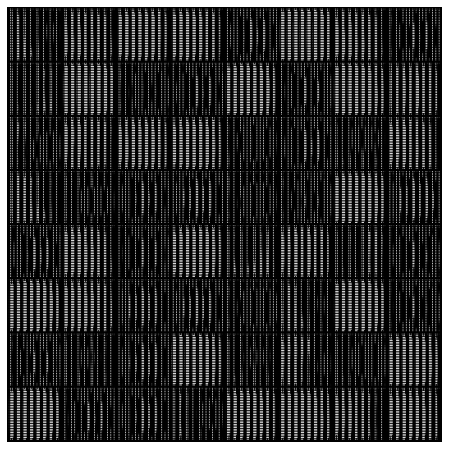

In [9]:
animate_gen_imgs()

# Trian : izif E

In [10]:
DC.eval()
D.eval()

kappa = 1.0
EC_losses = []

iters = 0
AE_img_list = []

def train_AE(epoch):
    global epochs
    global iters
    global EC_losses
    global AE_img_list
    
    # 인덱스 0부터 세기 시작
    # data[0].size():64x1x64x64(image) / data[1].size():64(label)
    for i,data in enumerate(data_loader,0):
        
        real_imgs = data[0].to(device)
        
        EC_optimizer.zero_grad()
        
        EC_validity = EC(real_imgs)
        
        fake_imgs = DC(EC_validity)
        
        _, real_features = D.forward(real_imgs)
        _, fake_features = D.forward(fake_imgs)
        
        
        # izif architecture
        imgs_loss = AE_criterion(real_imgs, fake_imgs)
        features_loss = AE_criterion(real_features, fake_features)
        EC_loss = imgs_loss + kappa*features_loss
        
        EC_loss.backward()
        EC_optimizer.step()
        
        # =============================================================
        # print
        # =============================================================
        print('[%d/%d][%d/%d]\n- E_loss: %.4f\n'
              %(epoch+1, epochs, i, len(data_loader), EC_loss.item()))
        
        # Save Losses for plotting later
        EC_losses.append(EC_loss.item())
        
        #Check how the generator is doing by saving G's output on noise_z
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = DC(EC_validity).detach().cpu()
            AE_img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        
#torch.save(E.state_dict(), 'E.ckpt')

In [11]:
for epoch in range(epochs):
    train_AE(epoch)

[1/100][0/21]
- E_loss: 1.4498

[1/100][1/21]
- E_loss: 1.2860

[1/100][2/21]
- E_loss: 1.2490

[1/100][3/21]
- E_loss: 1.1749

[1/100][4/21]
- E_loss: 1.2461

[1/100][5/21]
- E_loss: 1.1912

[1/100][6/21]
- E_loss: 1.2265

[1/100][7/21]
- E_loss: 1.1665

[1/100][8/21]
- E_loss: 1.2650

[1/100][9/21]
- E_loss: 1.2565

[1/100][10/21]
- E_loss: 1.2233

[1/100][11/21]
- E_loss: 1.1661

[1/100][12/21]
- E_loss: 1.2154

[1/100][13/21]
- E_loss: 1.2006

[1/100][14/21]
- E_loss: 1.1956

[1/100][15/21]
- E_loss: 1.2827

[1/100][16/21]
- E_loss: 1.2896

[1/100][17/21]
- E_loss: 1.2056

[1/100][18/21]
- E_loss: 1.2572

[1/100][19/21]
- E_loss: 1.1831

[1/100][20/21]
- E_loss: 1.2922

[2/100][0/21]
- E_loss: 1.2641

[2/100][1/21]
- E_loss: 1.2293

[2/100][2/21]
- E_loss: 1.1955

[2/100][3/21]
- E_loss: 1.1766

[2/100][4/21]
- E_loss: 1.1928

[2/100][5/21]
- E_loss: 1.2836

[2/100][6/21]
- E_loss: 1.2371

[2/100][7/21]
- E_loss: 1.1844

[2/100][8/21]
- E_loss: 1.2584

[2/100][9/21]
- E_loss: 1.253

[13/100][0/21]
- E_loss: 1.2227

[13/100][1/21]
- E_loss: 1.1985

[13/100][2/21]
- E_loss: 1.2578

[13/100][3/21]
- E_loss: 1.2396

[13/100][4/21]
- E_loss: 1.2018

[13/100][5/21]
- E_loss: 1.1843

[13/100][6/21]
- E_loss: 1.2049

[13/100][7/21]
- E_loss: 1.2340

[13/100][8/21]
- E_loss: 1.2764

[13/100][9/21]
- E_loss: 1.2527

[13/100][10/21]
- E_loss: 1.2105

[13/100][11/21]
- E_loss: 1.2293

[13/100][12/21]
- E_loss: 1.2125

[13/100][13/21]
- E_loss: 1.2450

[13/100][14/21]
- E_loss: 1.1693

[13/100][15/21]
- E_loss: 1.2475

[13/100][16/21]
- E_loss: 1.2002

[13/100][17/21]
- E_loss: 1.2514

[13/100][18/21]
- E_loss: 1.2540

[13/100][19/21]
- E_loss: 1.2522

[13/100][20/21]
- E_loss: 1.1941

[14/100][0/21]
- E_loss: 1.1574

[14/100][1/21]
- E_loss: 1.1456

[14/100][2/21]
- E_loss: 1.1809

[14/100][3/21]
- E_loss: 1.3256

[14/100][4/21]
- E_loss: 1.2396

[14/100][5/21]
- E_loss: 1.2224

[14/100][6/21]
- E_loss: 1.2428

[14/100][7/21]
- E_loss: 1.2810

[14/100][8/21]
- E_loss: 1.2234


[24/100][15/21]
- E_loss: 1.2201

[24/100][16/21]
- E_loss: 1.2180

[24/100][17/21]
- E_loss: 1.3006

[24/100][18/21]
- E_loss: 1.2066

[24/100][19/21]
- E_loss: 1.2147

[24/100][20/21]
- E_loss: 1.2549

[25/100][0/21]
- E_loss: 1.2085

[25/100][1/21]
- E_loss: 1.1747

[25/100][2/21]
- E_loss: 1.2591

[25/100][3/21]
- E_loss: 1.1719

[25/100][4/21]
- E_loss: 1.2821

[25/100][5/21]
- E_loss: 1.1811

[25/100][6/21]
- E_loss: 1.2785

[25/100][7/21]
- E_loss: 1.2172

[25/100][8/21]
- E_loss: 1.2422

[25/100][9/21]
- E_loss: 1.2251

[25/100][10/21]
- E_loss: 1.2812

[25/100][11/21]
- E_loss: 1.2334

[25/100][12/21]
- E_loss: 1.2172

[25/100][13/21]
- E_loss: 1.2389

[25/100][14/21]
- E_loss: 1.2444

[25/100][15/21]
- E_loss: 1.2023

[25/100][16/21]
- E_loss: 1.1902

[25/100][17/21]
- E_loss: 1.2312

[25/100][18/21]
- E_loss: 1.1734

[25/100][19/21]
- E_loss: 1.2130

[25/100][20/21]
- E_loss: 1.2889

[26/100][0/21]
- E_loss: 1.2722

[26/100][1/21]
- E_loss: 1.2163

[26/100][2/21]
- E_loss: 1

[36/100][9/21]
- E_loss: 1.2253

[36/100][10/21]
- E_loss: 1.1861

[36/100][11/21]
- E_loss: 1.2425

[36/100][12/21]
- E_loss: 1.2478

[36/100][13/21]
- E_loss: 1.2191

[36/100][14/21]
- E_loss: 1.1820

[36/100][15/21]
- E_loss: 1.2482

[36/100][16/21]
- E_loss: 1.2929

[36/100][17/21]
- E_loss: 1.1913

[36/100][18/21]
- E_loss: 1.1397

[36/100][19/21]
- E_loss: 1.2086

[36/100][20/21]
- E_loss: 1.2779

[37/100][0/21]
- E_loss: 1.2084

[37/100][1/21]
- E_loss: 1.2580

[37/100][2/21]
- E_loss: 1.2425

[37/100][3/21]
- E_loss: 1.2364

[37/100][4/21]
- E_loss: 1.2451

[37/100][5/21]
- E_loss: 1.2716

[37/100][6/21]
- E_loss: 1.2553

[37/100][7/21]
- E_loss: 1.2663

[37/100][8/21]
- E_loss: 1.1782

[37/100][9/21]
- E_loss: 1.2018

[37/100][10/21]
- E_loss: 1.1954

[37/100][11/21]
- E_loss: 1.2279

[37/100][12/21]
- E_loss: 1.2006

[37/100][13/21]
- E_loss: 1.1970

[37/100][14/21]
- E_loss: 1.2109

[37/100][15/21]
- E_loss: 1.2127

[37/100][16/21]
- E_loss: 1.2213

[37/100][17/21]
- E_loss:

[48/100][3/21]
- E_loss: 1.2328

[48/100][4/21]
- E_loss: 1.2601

[48/100][5/21]
- E_loss: 1.1842

[48/100][6/21]
- E_loss: 1.2011

[48/100][7/21]
- E_loss: 1.2136

[48/100][8/21]
- E_loss: 1.3329

[48/100][9/21]
- E_loss: 1.2540

[48/100][10/21]
- E_loss: 1.2180

[48/100][11/21]
- E_loss: 1.1651

[48/100][12/21]
- E_loss: 1.3288

[48/100][13/21]
- E_loss: 1.2456

[48/100][14/21]
- E_loss: 1.2145

[48/100][15/21]
- E_loss: 1.1874

[48/100][16/21]
- E_loss: 1.2547

[48/100][17/21]
- E_loss: 1.2041

[48/100][18/21]
- E_loss: 1.2956

[48/100][19/21]
- E_loss: 1.1970

[48/100][20/21]
- E_loss: 1.1962

[49/100][0/21]
- E_loss: 1.2371

[49/100][1/21]
- E_loss: 1.2757

[49/100][2/21]
- E_loss: 1.2176

[49/100][3/21]
- E_loss: 1.2581

[49/100][4/21]
- E_loss: 1.2219

[49/100][5/21]
- E_loss: 1.2141

[49/100][6/21]
- E_loss: 1.2117

[49/100][7/21]
- E_loss: 1.2418

[49/100][8/21]
- E_loss: 1.2566

[49/100][9/21]
- E_loss: 1.2792

[49/100][10/21]
- E_loss: 1.2103

[49/100][11/21]
- E_loss: 1.241

[59/100][18/21]
- E_loss: 1.2878

[59/100][19/21]
- E_loss: 1.2659

[59/100][20/21]
- E_loss: 1.1961

[60/100][0/21]
- E_loss: 1.2946

[60/100][1/21]
- E_loss: 1.2360

[60/100][2/21]
- E_loss: 1.2932

[60/100][3/21]
- E_loss: 1.2432

[60/100][4/21]
- E_loss: 1.2214

[60/100][5/21]
- E_loss: 1.2049

[60/100][6/21]
- E_loss: 1.1848

[60/100][7/21]
- E_loss: 1.2393

[60/100][8/21]
- E_loss: 1.2377

[60/100][9/21]
- E_loss: 1.2147

[60/100][10/21]
- E_loss: 1.2131

[60/100][11/21]
- E_loss: 1.1717

[60/100][12/21]
- E_loss: 1.2837

[60/100][13/21]
- E_loss: 1.2091

[60/100][14/21]
- E_loss: 1.1846

[60/100][15/21]
- E_loss: 1.1915

[60/100][16/21]
- E_loss: 1.2411

[60/100][17/21]
- E_loss: 1.2209

[60/100][18/21]
- E_loss: 1.1995

[60/100][19/21]
- E_loss: 1.1929

[60/100][20/21]
- E_loss: 1.2455

[61/100][0/21]
- E_loss: 1.1878

[61/100][1/21]
- E_loss: 1.2184

[61/100][2/21]
- E_loss: 1.2523

[61/100][3/21]
- E_loss: 1.2125

[61/100][4/21]
- E_loss: 1.1941

[61/100][5/21]
- E_loss: 1.20

[71/100][12/21]
- E_loss: 1.2188

[71/100][13/21]
- E_loss: 1.2196

[71/100][14/21]
- E_loss: 1.2107

[71/100][15/21]
- E_loss: 1.2364

[71/100][16/21]
- E_loss: 1.1876

[71/100][17/21]
- E_loss: 1.2540

[71/100][18/21]
- E_loss: 1.2531

[71/100][19/21]
- E_loss: 1.1969

[71/100][20/21]
- E_loss: 1.2333

[72/100][0/21]
- E_loss: 1.2316

[72/100][1/21]
- E_loss: 1.2382

[72/100][2/21]
- E_loss: 1.2183

[72/100][3/21]
- E_loss: 1.3171

[72/100][4/21]
- E_loss: 1.1994

[72/100][5/21]
- E_loss: 1.2087

[72/100][6/21]
- E_loss: 1.2328

[72/100][7/21]
- E_loss: 1.2050

[72/100][8/21]
- E_loss: 1.1514

[72/100][9/21]
- E_loss: 1.2526

[72/100][10/21]
- E_loss: 1.2399

[72/100][11/21]
- E_loss: 1.2406

[72/100][12/21]
- E_loss: 1.2389

[72/100][13/21]
- E_loss: 1.2376

[72/100][14/21]
- E_loss: 1.1806

[72/100][15/21]
- E_loss: 1.2049

[72/100][16/21]
- E_loss: 1.2191

[72/100][17/21]
- E_loss: 1.2256

[72/100][18/21]
- E_loss: 1.2848

[72/100][19/21]
- E_loss: 1.2101

[72/100][20/21]
- E_loss

[83/100][6/21]
- E_loss: 1.2380

[83/100][7/21]
- E_loss: 1.2486

[83/100][8/21]
- E_loss: 1.2227

[83/100][9/21]
- E_loss: 1.2922

[83/100][10/21]
- E_loss: 1.2306

[83/100][11/21]
- E_loss: 1.2021

[83/100][12/21]
- E_loss: 1.2360

[83/100][13/21]
- E_loss: 1.1475

[83/100][14/21]
- E_loss: 1.2312

[83/100][15/21]
- E_loss: 1.1899

[83/100][16/21]
- E_loss: 1.2725

[83/100][17/21]
- E_loss: 1.1893

[83/100][18/21]
- E_loss: 1.2430

[83/100][19/21]
- E_loss: 1.2262

[83/100][20/21]
- E_loss: 1.1757

[84/100][0/21]
- E_loss: 1.2702

[84/100][1/21]
- E_loss: 1.2433

[84/100][2/21]
- E_loss: 1.2322

[84/100][3/21]
- E_loss: 1.2554

[84/100][4/21]
- E_loss: 1.1900

[84/100][5/21]
- E_loss: 1.3107

[84/100][6/21]
- E_loss: 1.1894

[84/100][7/21]
- E_loss: 1.2528

[84/100][8/21]
- E_loss: 1.2395

[84/100][9/21]
- E_loss: 1.2082

[84/100][10/21]
- E_loss: 1.1868

[84/100][11/21]
- E_loss: 1.2351

[84/100][12/21]
- E_loss: 1.2144

[84/100][13/21]
- E_loss: 1.2152

[84/100][14/21]
- E_loss: 1.

[95/100][0/21]
- E_loss: 1.1877

[95/100][1/21]
- E_loss: 1.2527

[95/100][2/21]
- E_loss: 1.2212

[95/100][3/21]
- E_loss: 1.2420

[95/100][4/21]
- E_loss: 1.2324

[95/100][5/21]
- E_loss: 1.2401

[95/100][6/21]
- E_loss: 1.2514

[95/100][7/21]
- E_loss: 1.2138

[95/100][8/21]
- E_loss: 1.2147

[95/100][9/21]
- E_loss: 1.2604

[95/100][10/21]
- E_loss: 1.2039

[95/100][11/21]
- E_loss: 1.2085

[95/100][12/21]
- E_loss: 1.1863

[95/100][13/21]
- E_loss: 1.2458

[95/100][14/21]
- E_loss: 1.2254

[95/100][15/21]
- E_loss: 1.1994

[95/100][16/21]
- E_loss: 1.2225

[95/100][17/21]
- E_loss: 1.2288

[95/100][18/21]
- E_loss: 1.2176

[95/100][19/21]
- E_loss: 1.2299

[95/100][20/21]
- E_loss: 1.2182

[96/100][0/21]
- E_loss: 1.1806

[96/100][1/21]
- E_loss: 1.2436

[96/100][2/21]
- E_loss: 1.1980

[96/100][3/21]
- E_loss: 1.2153

[96/100][4/21]
- E_loss: 1.2630

[96/100][5/21]
- E_loss: 1.2356

[96/100][6/21]
- E_loss: 1.1788

[96/100][7/21]
- E_loss: 1.2483

[96/100][8/21]
- E_loss: 1.1999


# Loss Graph

In [12]:
def plot_train_loss():
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(DC_losses, label="G")
    plt.plot(D_losses, label="D")
    plt.plot(EC_losses, label="E")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

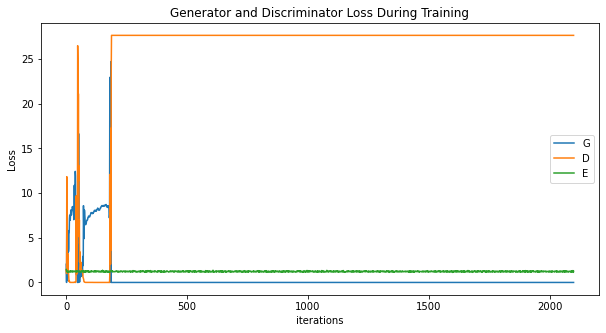

In [13]:
plot_train_loss()

---

# Test Data

In [15]:
#test_data_root = "../../dataset/test/test_DualPhaseSteel"
CFRP_test_data_root = "../../dataset/test/test_CFRP"

test_data_set = dataset.ImageFolder(root = CFRP_test_data_root, # test_data_root,
                           transform = transforms.Compose([
                                  transforms.Resize(img_size),
                                  transforms.CenterCrop(img_size),
                                  torchvision.transforms.Grayscale(channel),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5,),(0.5,))
                              ]))

# 배치로 나누고 셔플하기
test_data_loader = torch.utils.data.DataLoader(test_data_set, batch_size = 1,
                                              shuffle = False, num_workers = workers)

# 이상 픽셀 수 확인 함수

In [16]:
def count_el_not_0(diff_img):
    count_el_not_0 = 0
    
    col_size = diff_img.shape[0]
    row_size = diff_img.shape[1]
    
    #print(col_size, row_size)
    
    for col in range(col_size):
        for row in range(row_size):
            if diff_img[col][row] != 0:
                count_el_not_0 += 1
                
    return count_el_not_0

# img 비교 함수

In [17]:
def compare_imgs(real_img, generated_img, i, score, reverse=False, threshold=50):
    real_img = real_img.cpu().data.numpy().reshape(img_size, img_size) * 255
    generated_img = generated_img.cpu().data.numpy().reshape(img_size, img_size) * 255
    
    negative = np.zeros_like(real_img)

    if not reverse:
        diff_img = real_img - generated_img
    else:
        diff_img = generated_img - real_img

    diff_img[diff_img <= threshold] = 0

    # 분율 추출
    diff_cnts.append(count_el_not_0(diff_img))
    # 분산 추출
    diff_points.append(np.where(diff_img > threshold))
    
    anomaly_img = np.zeros(shape=(img_size, img_size, 3))
    anomaly_img[:, :, 0] = real_img - diff_img
    anomaly_img[:, :, 1] = real_img - diff_img
    anomaly_img[:, :, 2] = real_img - diff_img
    anomaly_img[:, :, 0] = anomaly_img[:,:,0] + diff_img
    anomaly_img = anomaly_img.astype(np.uint8)

    # anomaly_img 추출
    anomaly_imgs.append(anomaly_img)
    
    fig, plots = plt.subplots(1, 4)

    fig.suptitle(f'Anomaly - (anomaly score: {score:.4})')
    
    fig.set_figwidth(9)
    fig.set_tight_layout(True)
    plots = plots.reshape(-1)
    plots[0].imshow(real_img, cmap='gray', label = "real")
    plots[1].imshow(generated_img, cmap='gray')
    plots[2].imshow(diff_img, cmap='gray')
    plots[3].imshow(anomaly_img)
    
    plots[0].set_title('real')
    plots[1].set_title('generated')
    plots[2].set_title('difference')
    plots[3].set_title('Anomaly Detection')
    plt.show()

# Test

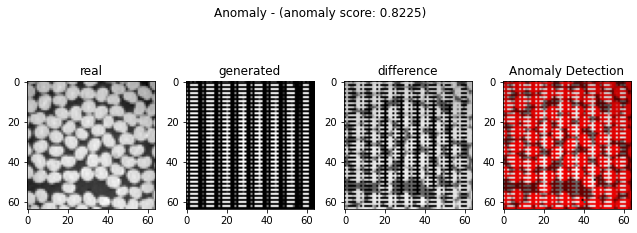

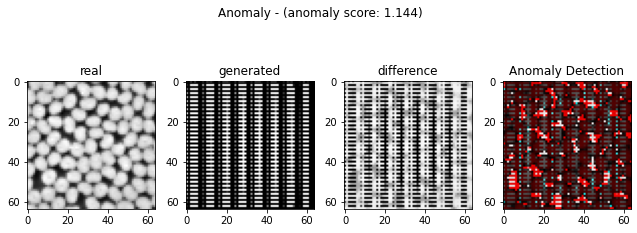

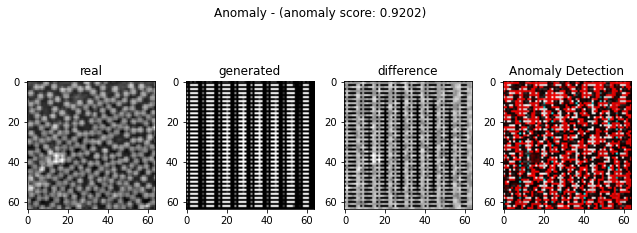

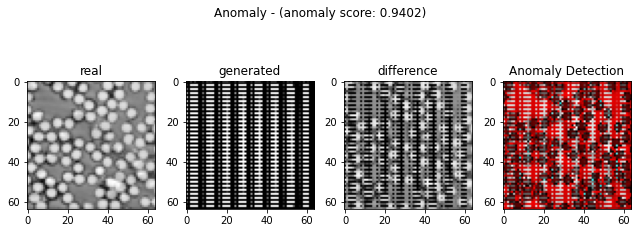

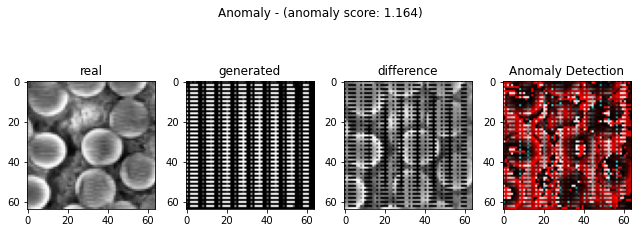

...

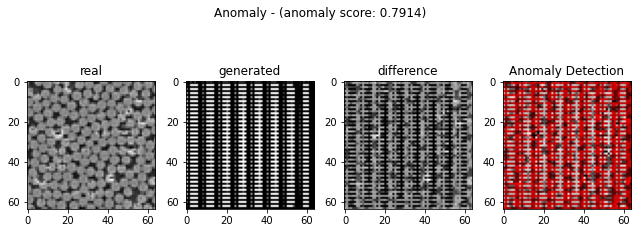

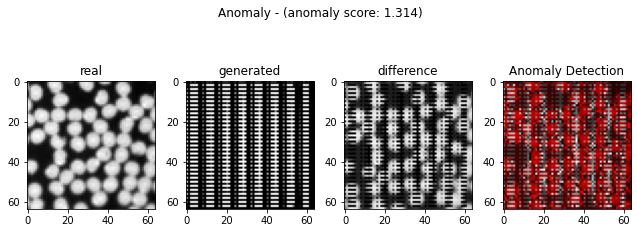

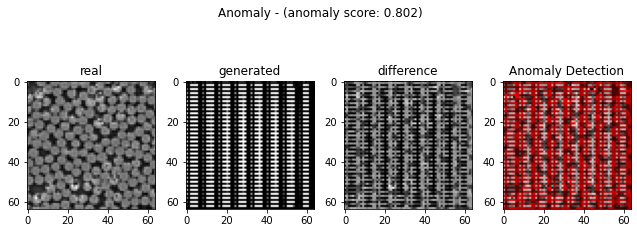

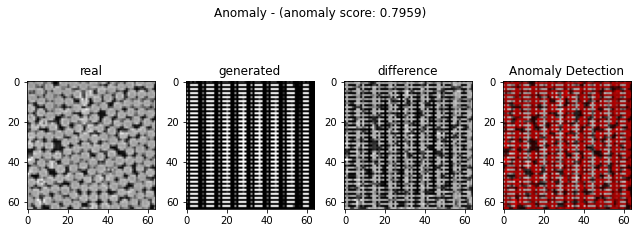

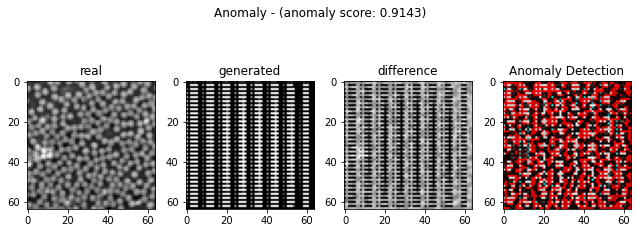

In [18]:
diff_cnts = []
diff_points = []
anomaly_imgs = []

ano_criterion = nn.MSELoss()
DC.eval()
D.eval()
EC.eval()

# with open("score.csv", "w") as f:
#         f.write("label,img_distance,anomaly_score,z_distance\n")

for i, data in enumerate(test_data_loader, 0):
    real_img = data[0].to(device)

    real_z = EC(real_img) # 진짜 이미지의 latent vector
    fake_img = DC(real_z) # DC에 넣어서 가짜 이미지 생성.
    fake_z = EC(fake_img) # torch.Size([1, 100]) --> latent 진짜 이미지와 매핑된 가짜 이미지의 latent vector

    _, real_feature = D.forward(real_img) # 1, 256
    _, fake_feature = D.forward(fake_img)

    img_distance = ano_criterion(fake_img, real_img)
    loss_feature = ano_criterion(fake_feature, real_feature)

    anomaly_score = img_distance + kappa*loss_feature

    z_distance = ano_criterion(fake_z, real_z)
    
#     with open("score.csv", "a") as f:
#             f.write(f"{label.item()},{img_distance},"
#                     f"{anomaly_score},{z_distance}\n")
            
#     print(f"{label.item()}, {img_distance}, "
#           f"{anomaly_score}, {z_distance}\n")
    compare_imgs(real_img, fake_img, i, anomaly_score, reverse = False, threshold = 0.3)

---

# 분율 추출

In [19]:
diff_cnts = np.array(diff_cnts)

diff_fraction = diff_cnts / img_size ** 2

print(diff_fraction)

[0.68481445 0.71923828 0.70068359 0.69946289 0.71435547 0.69311523
 0.72583008 0.72094727 0.70166016 0.7043457  0.68505859 0.68286133
 0.70385742 0.70507812 0.71728516 0.68383789 0.69555664 0.6965332
 0.68896484 0.70483398 0.68798828 0.69775391 0.71435547 0.67773438
 0.71386719 0.69995117 0.71240234 0.70483398 0.71044922 0.70678711
 0.70288086 0.69946289 0.71264648 0.68896484 0.71850586 0.70288086
 0.72387695 0.6862793  0.70458984 0.70727539 0.67700195 0.70581055
 0.6875     0.67626953 0.7121582  0.72460938 0.6809082  0.70507812
 0.67944336 0.71264648 0.73925781 0.67895508 0.67016602 0.69946289
 0.71606445 0.68212891 0.7109375  0.67822266 0.67602539 0.69995117]


In [20]:
sum(diff_fraction)/len(diff_fraction)

0.7002400716145833

---

# 분산 추출

In [21]:
from scipy import stats
from extended_int import int_inf

corr_coeffis = []
corr_p_vals = []

def cal_corr_coeffis():
    for idx in range(len(test_data_loader)):
        x_points = diff_points[idx][0]
        y_points = diff_points[idx][1]
        
        
        if len(x_points) > 0:
            corr_coeffi, corr_p_val = stats.pearsonr(x_points, y_points)
        else:
            corr_coeffi, corr_p_val = -int_inf, -int_inf
        
        corr_coeffis.append(corr_coeffi)
        corr_p_vals.append(corr_p_val)

In [22]:
cal_corr_coeffis()

print(corr_coeffis)

[-0.003400574486479469, -0.0039422401644912085, -0.005692674641779033, -0.0027853378439799945, -0.002484316448955459, -0.0022399838660888145, -0.00702860623055893, -0.0028557064154340617, -0.004651386264830729, -0.0031987284635447456, -0.007337778790414639, -0.005447157689800048, -0.002443253557553266, -0.001298633086995309, -0.000642010420995048, -0.002000667787417266, -0.006111467007121228, -0.004616238694944647, 0.002752252921014112, -0.004228310294533893, -0.004669269897296609, -0.0031518652719245816, -0.0026185282293660723, -0.003932910592658344, -0.0038847467256611437, -0.0005720992498806574, -0.006246723180449741, -0.004800621931323492, -0.005084889331065427, -0.002096584286510687, -0.0010915698610988386, -0.001488996237135289, -0.0051066413415337625, -0.0039895723096257125, -0.003529009427414622, -0.0047240105907663974, -0.008415350865357519, -0.003939114096674955, -0.0034205148970017423, 2.323340588792364e-05, -0.0035325481401193644, -0.002641472330320775, -0.00479402239512473

---

# 모델 저장 및 읽기

In [23]:
save_file = "./pretrained/pretrained.pth"

def save_pretrained():
    pretrained = {
        "D" : D.state_dict(),
        "DC" : DC.state_dict(),
        "EC" : EC.state_dict()
    }

    if not os.path.isdir("pretrained"):
        os.mkdir("pretrained")
    torch.save(pretrained, save_file)

In [24]:
save_pretrained()

In [25]:
pretrained_D = Discriminator().to(device)
pretrained_DC = Decoder().to(device)
pretrained_EC = Encoder().to(device)

def load_pretrained():
    global pretrained_D
    global pretrained_DC
    global pretrained_EC
    
    assert os.path.isdir("pretrained"), "Error : no pretrained dir found!"
    
    pretrained = torch.load(save_file)
    
    pretrained_D.load_state_dict(pretrained["D"])
    pretrained_DC.load_state_dict(pretrained["DC"])
    pretrained_EC.load_state_dict(pretrained["EC"])
    
    #print("pretrained_D :", pretrained_D)
    #print("pretrained_G :", pretrained_DC)
    #print("pretrained_E :", pretrained_EC)

In [26]:
load_pretrained()

In [27]:
def test():
    ano_criterion = nn.MSELoss()
    pretrained_DC.eval()
    pretrained_D.eval()
    pretrained_EC.eval()

    # with open("score.csv", "w") as f:
    #         f.write("label,img_distance,anomaly_score,z_distance\n")

    for i, data in enumerate(test_data_loader, 0):
        real_img = data[0].to(device)

        real_z = pretrained_EC(real_img) # 진짜 이미지의 latent vector
        fake_img = pretrained_DC(real_z) # DC에 넣어서 가짜 이미지 생성.
        fake_z = pretrained_EC(fake_img) # torch.Size([1, 100]) --> latent 진짜 이미지와 매핑된 가짜 이미지의 latent vector

        _, real_feature = pretrained_D.forward(real_img) # 1, 256
        _, fake_feature = pretrained_D.forward(fake_img)

        img_distance = ano_criterion(fake_img, real_img)
        loss_feature = ano_criterion(fake_feature, real_feature)

        anomaly_score = img_distance + kappa*loss_feature

        z_distance = ano_criterion(fake_z, real_z)

    #     with open("score.csv", "a") as f:
    #             f.write(f"{label.item()},{img_distance},"
    #                     f"{anomaly_score},{z_distance}\n")

    #     print(f"{label.item()}, {img_distance}, "
    #           f"{anomaly_score}, {z_distance}\n")
        compare_imgs(real_img, fake_img, i, anomaly_score, reverse = False, threshold = 0.3)

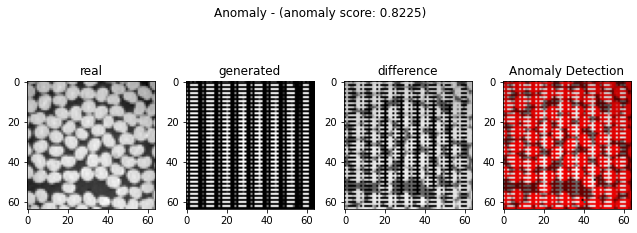

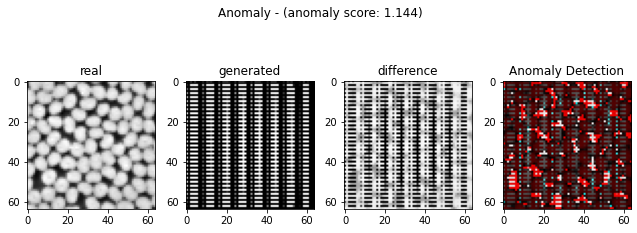

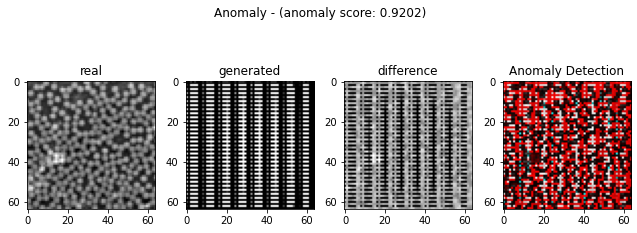

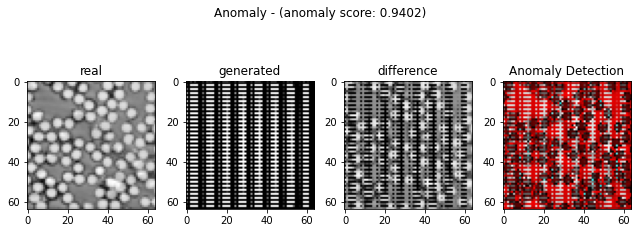

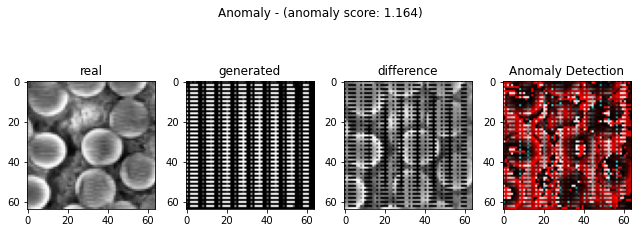

...

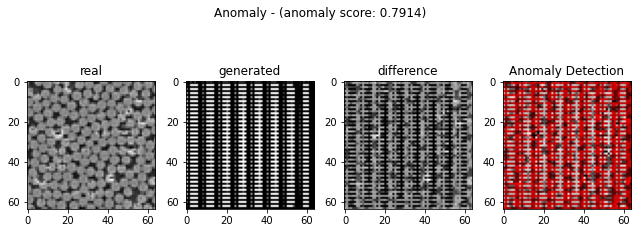

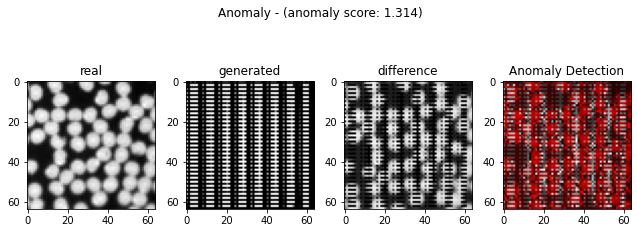

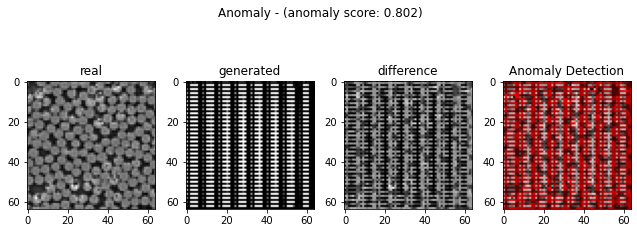

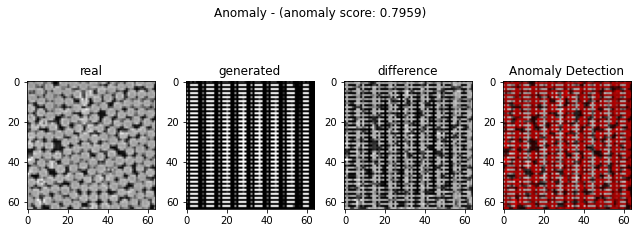

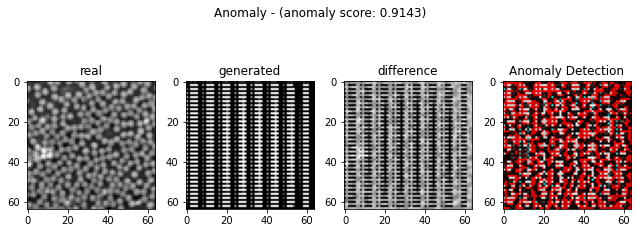

In [28]:
diff_cnts = []
diff_points = []
anomaly_imgs = []

corr_coeffis = []
corr_p_vals = []

test()

In [29]:
diff_cnts = np.array(diff_cnts)

diff_fraction = diff_cnts / img_size ** 2

print(diff_fraction)

[0.68481445 0.71923828 0.70068359 0.69946289 0.71435547 0.69311523
 0.72583008 0.72094727 0.70166016 0.7043457  0.68505859 0.68286133
 0.70385742 0.70507812 0.71728516 0.68383789 0.69555664 0.6965332
 0.68896484 0.70483398 0.68798828 0.69775391 0.71435547 0.67773438
 0.71386719 0.69995117 0.71240234 0.70483398 0.71044922 0.70678711
 0.70288086 0.69946289 0.71264648 0.68896484 0.71850586 0.70288086
 0.72387695 0.6862793  0.70458984 0.70727539 0.67700195 0.70581055
 0.6875     0.67626953 0.7121582  0.72460938 0.6809082  0.70507812
 0.67944336 0.71264648 0.73925781 0.67895508 0.67016602 0.69946289
 0.71606445 0.68212891 0.7109375  0.67822266 0.67602539 0.69995117]


In [30]:
cal_corr_coeffis()

print(corr_coeffis)

[-0.003400574486479469, -0.0039422401644912085, -0.005692674641779033, -0.0027853378439799945, -0.002484316448955459, -0.0022399838660888145, -0.00702860623055893, -0.0028557064154340617, -0.004651386264830729, -0.0031987284635447456, -0.007337778790414639, -0.005447157689800048, -0.002443253557553266, -0.001298633086995309, -0.000642010420995048, -0.002000667787417266, -0.006111467007121228, -0.004616238694944647, 0.002752252921014112, -0.004228310294533893, -0.004669269897296609, -0.0031518652719245816, -0.0026185282293660723, -0.003932910592658344, -0.0038847467256611437, -0.0005720992498806574, -0.006246723180449741, -0.004800621931323492, -0.005084889331065427, -0.002096584286510687, -0.0010915698610988386, -0.001488996237135289, -0.0051066413415337625, -0.0039895723096257125, -0.003529009427414622, -0.0047240105907663974, -0.008415350865357519, -0.003939114096674955, -0.0034205148970017423, 2.323340588792364e-05, -0.0035325481401193644, -0.002641472330320775, -0.00479402239512473

---

# anomaly detection 이미지 추출

In [31]:
anomaly_imgs

[array([[[188,  91,  91],
         [191,   2,   2],
         [194, 194, 194],
         ...,
         [179,   2,   2],
         [185,   4,   4],
         [185,   3,   3]],
 
        [[135,   2,   2],
         [179,   1,   1],
         [181,   1,   1],
         ...,
         [189,   2,   2],
         [183,   1,   1],
         [187,   2,   2]],
 
        [[186,  91,  91],
         [179,   1,   1],
         [127, 127, 127],
         ...,
         [187,   1,   1],
         [183,   1,   1],
         [189,   2,   2]],
 
        ...,
 
        [[179,   2,   2],
         [205,   2,   2],
         [205,   1,   1],
         ...,
         [225,   2,   2],
         [231,   1,   1],
         [149,   2,   2]],
 
        [[172,  67,  67],
         [113,   1,   1],
         [198, 198, 198],
         ...,
         [227,   1,   1],
         [217,   1,   1],
         [165,   2,   2]],
 
        [[187,   2,   2],
         [165,   2,   2],
         [221,   2,   2],
         ...,
         [225,   2,   2],
  

# 이미지 저장 함수

In [32]:
import cv2

def save_imgs(folder, imgs):
    if not os.path.isdir("anomaly_imgs"):
        os.mkdir("anomaly_imgs")
    
    for i in range(len(imgs)):
        cv2.imwrite('%s/%d.png' %(folder,i), imgs[i]) #이미지 저장할 경로 설정을 여기서 한다.
    print("image saving complete")

In [33]:
save_imgs("./anomaly_imgs", anomaly_imgs)

image saving complete


---

# 티타늄(Ti64) 상대 밀도 계산

In [34]:
Ti64_density = 4.43

Ti64_rel_densitys = np.array([])

Ti64_rel_densitys = diff_fraction * Ti64_density

print(Ti64_rel_densitys)

[3.03372803 3.18622559 3.10402832 3.09862061 3.16459473 3.07050049
 3.21542725 3.19379639 3.10835449 3.12025146 3.03480957 3.02507568
 3.11808838 3.12349609 3.17757324 3.02940186 3.08131592 3.08564209
 3.05211426 3.12241455 3.04778809 3.0910498  3.16459473 3.00236328
 3.16243164 3.10078369 3.15594238 3.12241455 3.14729004 3.13106689
 3.11376221 3.09862061 3.15702393 3.05211426 3.18298096 3.11376221
 3.2067749  3.04021729 3.12133301 3.13322998 2.99911865 3.12674072
 3.045625   2.99587402 3.15486084 3.21001953 3.01642334 3.12349609
 3.00993408 3.15702393 3.27491211 3.007771   2.96883545 3.09862061
 3.17216553 3.02183105 3.14945312 3.00452637 2.99479248 3.10078369]
